# SIMULASI GERAK JATUH BEBAS
Ardiansah Nur Rohman  
Departemen Fisika UM  
**FMIPA**

In [45]:
%matplotlib widget

In [46]:
import matplotlib.pyplot as plt
import matplotlib.animation as animation

### Definis Fungsi
Fungsi Generator Menghitung Posisi Bola

$$
\begin{aligned}
t_{i} &= t_{i-1} + dt\\
x_{i} &= x_{i-1} + v_{fx_0}dt\\
y_{i} &= y_{i-1} + v_{y_{i-1}}dt\\
v_{y_{i}} &= v_{y_{i-1}} + g dt
\end{aligned}
$$

Dalam Persamaan di atas karena $v_x$ adalah konstan maka tidak dilakukan perubahan.

untuk mendeteksi apakah bola mengenai lantai maka digunakan rumus :
$$
y_i < R
$$

Pada kenyataanya dalam komputasi karena perpindahan bola menggunakan nilai diskrit sebesar $dt$ maka dimungkinkan
posisi bola terakhir lebih kecil dari $R$ yang berarti bola menembus lantai. Karena tidak diijinkan menembus lantai jikaterdeteksi posisi $y<R$ makan 
$y=R$. Ilustrasi ini digambar.

![Bola Pantul](fotobola.jpeg)\
Gambar 1. Gerak Jatuh Bebas



In [47]:
# Generator posisi bola dari waktu ke waktu
def get_pos(t=0):           # Fungsi generator dengan t adalah waktu awal = 0
    x, y, vx, vy = x0, y0, vx0, vy0
    while x < XMAX:
        t += dt             # waktu t bertambah tiap langkah dt
        x += vx0 * dt       # menambah jarak gerak horizontal konstan
        y += vy * dt        # menambah jarak gerak vertikal
        vy -= g * dt        # kecepatan vertikal akibat percepatan gravitasi
        if y < R:           # jika menyentuh tanah
            y = R           # set y setinggi R agar bola tidak nampak tenggelam
            vy = -vy * cor  # pantulan dengan mengubah polaritas dan dikurangi akibat energi hilang
        yield x, y          # hasilkan posisi sekarang sebagai tuple (x,y) untuk animasi selanjutnya

Inisialisasi Tampilan Awal

In [48]:
# Inisialisasi tampilan awal animasi
def init():
    ax.set_xlim(0, XMAX)          # mengatur batas aksis x
    ax.set_ylim(0, y0)            # mengatur batas aksis y
    ax.set_xlabel("$x$ (m)")      # teks keterangan aksis x, $x$ untuk kode latex, x tampil italic 
    ax.set_ylabel("$y$ (m)")      # teks keterangan aksis x
    line.set_data(xdata, ydata)   # buat garis dari xdata, ydata
    ball.set_center((x0, y0))     # pengaturan lokasi tengan bola sebagai koordinat acuan bola
    height_text.set_text(f"Ketinggian: {y0:.2f} m")  # menulis variabel y0 ke obyek height_text  
    return line, ball, height_text  # mengirim hasil pengubahan ke pemanggil fungsi init

Fungsi Untuk Memperbarui animasi Tiap Frame

In [49]:
# Fungsi untuk memperbarui animasi setiap frame
def animate(pos):
    x, y = pos                    # ambil x dan y dari parameter pos
    xdata.append(x)               # tambahkan x ke xdata
    ydata.append(y)               # tambahkan y ke ydata
    line.set_data(xdata, ydata)   # masukkan ke line
    ball.set_center((x, y))       # letakkan bola di posisi x, y
    height_text.set_text(f"Ketinggian: {y:.2f} m")
    return line, ball, height_text

Persiapan Parameter Fisika dan Simulasi

In [50]:
# Parameter fisika dan simulasi
g = 9.81        # Percepatan gravitasi (m/s^2)
XMAX = 5        # Batas horizontal lintasan bola
cor = 0.65      # Koefisien restitusi (pantulan)
dt = 0.005      # Langkah waktu untuk animasi

# Posisi dan kecepatan awal
x0, y0    = 0, 4
vx0, vy0  = 1, 0
R         = 0.08  # Jari-jari bola

Persiapan Obyek visual dan Animasi

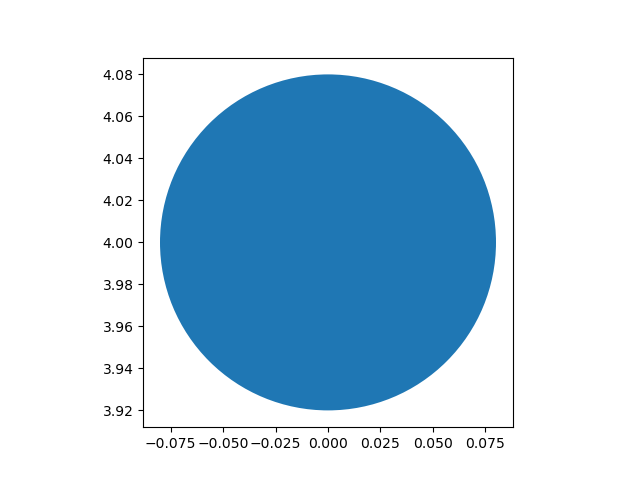

Animation size has reached 21000951 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [51]:
# Atur figure dan objek visual
fig, ax = plt.subplots()         # fig adalah gambar keseluruhan, ax adalah gambar grafik di dalamnya
ax.set_aspect("equal")           # Mengatur ukuran sumbu x dan y sama
(line,) = ax.plot([], [], lw=2)  # garis lintasan dengan data x dan y kosong
ball = plt.Circle((x0, y0), R)   # bola dengan radius R ==> belum ada di axes, masih definisi
ax.add_patch(ball)               # tambahkan bola ke axes
xdata, ydata = [], []            # data lintasan masih kosong
# teks ketinggian, f di depan string adalah f-string dimana string bisa menampilkan nilai variabel 
# dengan menulis {variabel}
height_text = ax.text(XMAX * 0.5, y0 * 0.8, f"Ketinggian: {y0:.2f} m")
# Jalankan animasi
interval = 2000 * dt
ani = animation.FuncAnimation(
                fig=fig,            # obyek gambar yang akan dianimasikan
                func=animate,       # fungsi animasi
                frames=get_pos,     # penghitungan posisi tiap frame
                blit=True,
                interval=interval,
                repeat=False,
                init_func=init,
                cache_frame_data=False
                )
plt.show()
from IPython.display import HTML
plt.close(fig)
#menampilkan 
HTML(ani.to_jshtml())